In [1]:
import sklearn
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

from IPython.display import display, Markdown, Latex

# Визуальный анализ данных


## Типы признаков

В `dataset`'e предлагаются следующие признаки:
* `motor` - принимает значения A,B,C,D,E;
* `screw` - принимает значения A,B,C,D,E;
* `pgain` - принимает значения 3,4,5,6;
* `vgain` - принимает значения 1,2,3,4,5,6;

и таргет:
* `class` - принимает значения от 0.13 to 7.10;

Нетрудно заметить, что значения признаков принимают только положительные значения.


In [2]:
import pandas as pd

# URL of the dataset
url = "https://archive.ics.uci.edu/ml/machine-learning-databases/servo/servo.data"

# Column names for the dataset (as specified in the dataset description)
column_names = ["motor", "screw", "pgain", "vgain", "class"]

# Loading the dataset into a DataFrame
servo_df = pd.read_csv(url, names=column_names)

# Displaying 5 objects with targets
servo_df.sample(5, random_state = 0)

,motor,screw,pgain,vgain,class
150,B,A,5,4,0.806255
56,A,A,4,2,0.881255
123,C,E,3,1,1.299997
60,E,B,4,2,0.581253
100,B,C,4,2,0.506252


## Визуальный анализ

Можно обратить внимание на некоторые:
* pgain vgain и class сильно коррелируют
* остальные призаки не зависят друг от друга.

/home/arman/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/arman/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/arman/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/arman/.local/lib/python3.10/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if

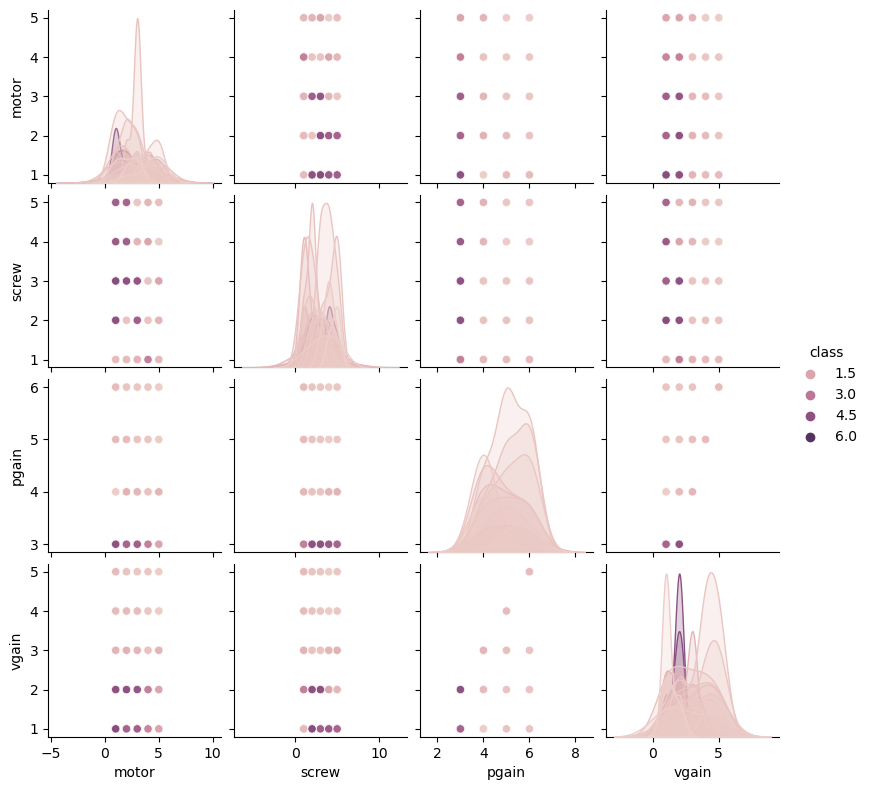

In [3]:
motor_mapping = {'A': 1, 'B': 2, 'C': 3, 'D': 4, 'E': 5}
screw_mapping = {'A': 1, 'B': 2, 'C': 3, 'D': 4, 'E': 5}
servo_df['motor'] = servo_df['motor'].map(motor_mapping)
servo_df['screw'] = servo_df['screw'].map(screw_mapping)

sns.pairplot(servo_df, hue='class', height=2)

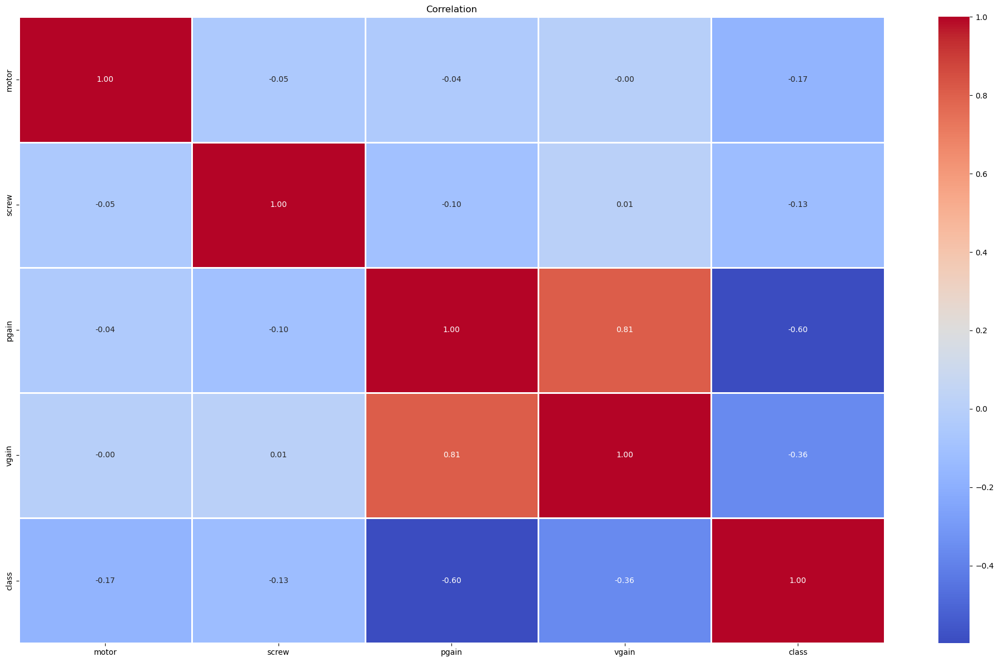

In [4]:
correlation = servo_df.corr()
plt.figure(figsize = (20, 12))
sns.heatmap(correlation, linewidths = 1, annot = True, fmt = ".2f", cmap = 'coolwarm')
plt.title("Correlation")
plt.tight_layout()
plt.show()

# Препроцессинг данных


### Сразу же сделаем нормировку данных

сначала разобъем признаки принимающие значения из определенного диапазона на отдельные признаки с бинарной категоризацией, затем отнормируем величину таргета, чтобы он принимали значения от нуля до единицы

In [5]:
# Perform one-hot encoding on categorical features
servo_df_encoded = pd.get_dummies(servo_df, columns=['motor', 'screw', 'pgain', 'vgain'])

# Displaying 5 objects with targets
servo_df_encoded.sample(5, random_state = 0)

,class,motor_1,motor_2,motor_3,motor_4,motor_5,screw_1,screw_2,screw_3,screw_4,screw_5,pgain_3,pgain_4,pgain_5,pgain_6,vgain_1,vgain_2,vgain_3,vgain_4,vgain_5
150,0.806255,False,True,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,True,False
56,0.881255,True,False,False,False,False,True,False,False,False,False,False,True,False,False,False,True,False,False,False
123,1.299997,False,False,True,False,False,False,False,False,False,True,True,False,False,False,True,False,False,False,False
60,0.581253,False,False,False,False,True,False,True,False,False,False,False,True,False,False,False,True,False,False,False
100,0.506252,False,True,False,False,False,False,False,True,False,False,False,True,False,False,False,True,False,False,False


In [6]:
from sklearn.preprocessing import MinMaxScaler

# Normalize the features (excluding the target variable 'class')
scaler = MinMaxScaler()
features = servo_df_encoded.drop('class', axis=1)
normalized_features = scaler.fit_transform(features)

# Create a new DataFrame with normalized features
servo_df_normalized = pd.DataFrame(normalized_features, columns=features.columns)
servo_df_normalized['class'] = servo_df_encoded['class']

# Display the normalized DataFrame
servo_df_normalized.sample(5, random_state = 0)

,motor_1,motor_2,motor_3,motor_4,motor_5,screw_1,screw_2,screw_3,screw_4,screw_5,pgain_3,pgain_4,pgain_5,pgain_6,vgain_1,vgain_2,vgain_3,vgain_4,vgain_5,class
150,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.806255
56,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.881255
123,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.299997
60,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.581253
100,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.506252


## Разбивка данных на train/test

In [7]:
from sklearn.model_selection import train_test_split

X = servo_df_normalized.drop(['class'], axis = 1)
Y = servo_df_normalized['class']

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 42)

## Набор полезных функций (подбор гиперпараметров, ...)

In [8]:
from sklearn.model_selection import LeaveOneOut, KFold, ShuffleSplit
from sklearn.model_selection import ParameterGrid
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import mean_squared_error


# Линейная регрессия

In [9]:
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import (LogisticRegression,
                                  LinearRegression)

X_train_regr = X_train.copy()
X_train_regr = np.hstack([X_train_regr, np.ones([len(X_train_regr), 1])])

X_test_regr = X_test.copy()
X_test_regr = np.hstack([X_test_regr, np.ones([len(X_test_regr), 1])])

model = LinearRegression(fit_intercept=False)

model = LinearRegression(fit_intercept=False)
_ = model.fit(X_train_regr, Y_train)

# Построим относительную ошибку на всей выборке.
y_pred = model.predict(X_test_regr)
#df_diff = df.copy()
#df_diff[target] = (y_pred - y) / y

print("Coefficients: \n", model.coef_)
print("Mean squared error: %.2f" % mean_squared_error(Y_test, y_pred))
print("Coefficient of determination: %.2f" % r2_score(Y_test, y_pred))

Coefficients: 
 [ 0.61869857  0.57277879  0.22073981 -0.81007236 -0.03503795  0.92739438
  0.3207193  -0.10772164 -0.27139555 -0.30188963  2.78632968 -0.10023985
 -1.16066889 -0.95831408 -0.53078746 -0.21748423  0.10874916  0.70688643
  0.49974296  0.56710687]
Mean squared error: 0.41
Coefficient of determination: 0.83


# Перцептрон и SVR

In [11]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.svm import SVR

# Гиперпараметры для подбора
param_grids = {
    'Перцептрон': {
        'hidden_layer_sizes': [(50,), (100,), (50, 50)],
        'activation': ['relu', 'tanh'],
        'solver': ['adam', 'sgd'],
        'alpha': [0.0001, 0.001, 0.01]
    },
    'SVR': {
        'C': [1e-2, .1, .10, .100],
        'kernel': ['linear', 'rbf', 'sigmoid', 'poly'],
        'gamma': [0.052, 0.1, 0.52, 1.52, .4, .6, .8],
        'epsilon': [1e-4, 1e-3, 1e-2, .1],
        'degree': [1, 2, 3, 4]
    }
}

# Список моделей для тестирования
models = {
    'Перцептрон': MLPRegressor(max_iter=5000),
    'SVR': SVR()
}

cvs = {
    'suffle': ShuffleSplit(n_splits = 5, test_size = 0.25, random_state = 0),
    'fold': KFold(n_splits = 10)
}

# Проведение экспериментов для каждой модели
best_models = {'suffle': {}, 'fold':{}}
for name, model in models.items():
    for cv_name, cv in cvs.items():
        print(f"\nПодбор гиперпараметров для модели: {name} c {cv_name}")
        grid_search = GridSearchCV(model, param_grids[name], cv=cv, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
        grid_search.fit(X_train, Y_train)
        best_models[cv_name][name] = grid_search.best_estimator_
        print(f"Лучшие параметры для {name} c {cv_name}: {grid_search.best_params_}")

# Оценка моделей
for sv_name in cvs:
    for name, model in best_models[sv_name].items():
        print(f"\nОценка модели с {sv_name}: {name}")
        y_pred = model.predict(X_test)
        mse = mean_squared_error(Y_test, y_pred)
        r2 = r2_score(Y_test, y_pred)
        print(f"Mean Squared Error: {mse}")
        print(f"R^2 Score: {r2}")



Подбор гиперпараметров для модели: Перцептрон c suffle
Fitting 5 folds for each of 36 candidates, totalling 180 fits
Лучшие параметры для Перцептрон c suffle: {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 50), 'solver': 'adam'}

Подбор гиперпараметров для модели: Перцептрон c fold
Fitting 10 folds for each of 36 candidates, totalling 360 fits
Лучшие параметры для Перцептрон c fold: {'activation': 'tanh', 'alpha': 0.01, 'hidden_layer_sizes': (50, 50), 'solver': 'adam'}

Подбор гиперпараметров для модели: SVR c suffle
Fitting 5 folds for each of 1792 candidates, totalling 8960 fits
Лучшие параметры для SVR c suffle: {'C': 0.1, 'degree': 3, 'epsilon': 0.0001, 'gamma': 0.8, 'kernel': 'poly'}

Подбор гиперпараметров для модели: SVR c fold
Fitting 10 folds for each of 1792 candidates, totalling 17920 fits
Лучшие параметры для SVR c fold: {'C': 0.1, 'degree': 2, 'epsilon': 0.1, 'gamma': 1.52, 'kernel': 'poly'}

Оценка модели с suffle: Перцептрон
Mean Squared Error: 0.600

# Итоги


Подведём краткие итоги изучения моделей и их анализа.

Наименьшую ошибку среди Perceptron, SVR и линейной регрессии даёт SVR с параметрами 'C': 0.1, 'degree': 2, 'epsilon': 0.1, 'gamma': 1.52, 'kernel': 'poly' полученными используя Fold валидацию.

Линейная регрессия дает результат хуже перцептрона, но конечно же второй дольше обучаетсся.

R2 crore: SVR - 0.94, перцептрон - 0.9, линейная регрессия - 0.83